# Aula 5

![](../../data/imagem/banner-pos-2022.jpg)

# Importando as bibliotecas

In [ ]:
import re
import os
import glob
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity

import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.layers import GlobalAvgPool2D
from tensorflow.keras.models import Model

# Download Modelo Base

In [2]:
base_model = ResNet50(weights="imagenet")
base_model.summary()

2025-05-19 16:34:45.732478: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


102967424/102967424 ━━━━━━━━━━━━━━━━━━━━ 183s 2us/step


Model: "resnet50"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 25,636,712 (97.80 MB)

 Trainable params: 25,583,592 (97.59 MB)

 Non-trainable params: 53,120 (207.50 KB)

# Criando o modelo de extração de features

In [4]:
feature_extractor = Model(
    inputs=base_model.input,
    outputs=base_model.get_layer('avg_pool').output
)

feature_extractor.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 23,534,592 (89.78 MB)

 Non-trainable params: 53,120 (207.50 KB)

# Preparação inicial

In [6]:
PATH_DIR = "../../data/coil-100"

images_path = sorted(glob.glob(f"{PATH_DIR}/*.png"))

images_name = [name.split('/')[-1] for name in images_path]

print(f"Total de {len(images_path)} imagens.")

Total de 7200 imagens.


In [7]:
objs = list(set([obj.split('_')[0] for obj in images_name]))
objs = sorted(objs, key=lambda x: int(re.search(r'\d+', x).group()))
print(f"Total de {len(objs)} objetos")

Total de 100 objetos


# Preparação da imagem e extração de feature

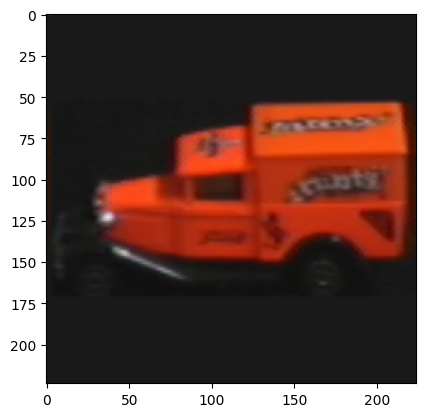

In [9]:
img = cv2.imread(images_path[0])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.resize(img, (224, 224))

plt.imshow(img)
plt.show()

In [43]:
x = np.expand_dims(img, axis=0)

pred = feature_extractor.predict(x, verbose=False)

pred.shape, pred.ravel().shape

((1, 2048), (2048,))

# Criando banco de dados de embeddings

In [ ]:
def read_and_preprocess_image(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (224, 224))    
    img = np.expand_dims(img, axis=0)
    return img

# Criando um banco de dados de embeddings
embeddings_list = []
image_embeddings = {}

for i in range(len(images_path)):
    image = read_and_preprocess_image(images_path[i])
    
    embedding = feature_extractor.predict(image, verbose=False).ravel()
    
    embeddings_list.append(embedding)
    image_embeddings[images_name[i]] = embedding

In [45]:
len(image_embeddings), len(embedding)

(7200, 2048)

In [46]:
# Salvar o "banco de dados"
np.savez("image_embeddings.npz", **image_embeddings)

In [ ]:
# Carregar o "banco de dados"
loaded_data = np.load("image_embeddings.npz")
dado_recuperado = {key: loaded_data[key] for key in loaded_data.files}

dado_recuperado

{'obj100__0.png': array([0.10592598, 0.12351739, 0.5239688 , ..., 2.357492  , 0.2029681 ,
        0.05975846], dtype=float32),
 'obj100__10.png': array([0.0496607 , 0.2342861 , 0.3821285 , ..., 2.4136543 , 0.8341832 ,
        0.06748708], dtype=float32),
 'obj100__100.png': array([0.8067307 , 0.51721644, 0.07446743, ..., 0.62021136, 2.0630834 ,
        0.05393699], dtype=float32),
 'obj100__105.png': array([0.6266693 , 0.47155276, 0.        , ..., 0.92778075, 1.4984314 ,
        0.03938937], dtype=float32),
 'obj100__110.png': array([0.2135095 , 0.18015696, 0.02982129, ..., 0.91841656, 1.4916652 ,
        0.        ], dtype=float32),
 'obj100__115.png': array([0.06286892, 0.09735007, 0.05286586, ..., 1.1505693 , 1.4052887 ,
        0.05235319], dtype=float32),
 'obj100__120.png': array([0.08035012, 0.20510675, 0.        , ..., 1.5833375 , 1.29657   ,
        0.17942514], dtype=float32),
 'obj100__125.png': array([0.02959413, 0.5213072 , 0.00682842, ..., 1.962242  , 1.0901195 ,
        

In [44]:
image_embeddings

{'obj100__0.png': array([0.10592598, 0.12351739, 0.5239688 , ..., 2.357492  , 0.2029681 ,
        0.05975846], dtype=float32),
 'obj100__10.png': array([0.0496607 , 0.2342861 , 0.3821285 , ..., 2.4136543 , 0.8341832 ,
        0.06748708], dtype=float32),
 'obj100__100.png': array([0.8067307 , 0.51721644, 0.07446743, ..., 0.62021136, 2.0630834 ,
        0.05393699], dtype=float32),
 'obj100__105.png': array([0.6266693 , 0.47155276, 0.        , ..., 0.92778075, 1.4984314 ,
        0.03938937], dtype=float32),
 'obj100__110.png': array([0.2135095 , 0.18015696, 0.02982129, ..., 0.91841656, 1.4916652 ,
        0.        ], dtype=float32),
 'obj100__115.png': array([0.06286892, 0.09735007, 0.05286586, ..., 1.1505693 , 1.4052887 ,
        0.05235319], dtype=float32),
 'obj100__120.png': array([0.08035012, 0.20510675, 0.        , ..., 1.5833375 , 1.29657   ,
        0.17942514], dtype=float32),
 'obj100__125.png': array([0.02959413, 0.5213072 , 0.00682842, ..., 1.962242  , 1.0901195 ,
        

# Funções Auxiliares

* `compute_similarity`: calcula a similaridade do cosseno entre duas imagens a partir dos seus embeddings.
* `plot_consult`: função para exibir a image consulta e as imagens mais similares.
* `consulta`: função que encapsula todo o processo de calcular a similaridade da imagem consulta com as demais imagens no banco e posteriormente exibi os resultados.

In [35]:
# Calcular a similaridade entre a imagem de consulta e as imagens do banco de dados
def compute_similarity(embedding1, embedding2):
    return cosine_similarity(
        embedding1.reshape(1,-1), 
        embedding2.reshape(1,-1)
    )[0][0]

def plot_consulta(query_image_path, sorted_images, similarities,
                  total_images, figsize=(10, 5)):

    # Exibir os resultados
    query_image = cv2.imread(query_image_path, cv2.IMREAD_COLOR)
    plt.figure(figsize=figsize)
    plt.subplot(1, len(sorted_images[:total_images]) + 1, 1)
    plt.imshow(cv2.cvtColor(query_image, cv2.COLOR_BGR2RGB))
    plt.title("Consulta")
    plt.axis("off")

    for i, img_path in enumerate(sorted_images[:total_images]):
        img = cv2.imread(f"{PATH_DIR}/{img_path}", cv2.IMREAD_COLOR)
        plt.subplot(1, len(sorted_images[:total_images]) + 1, i + 2)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Sim: {similarities[img_path]:.2f}")
        plt.axis("off")

    plt.show()

In [36]:
def consulta(obj, total_consultas=5, figsize=(10, 5)):
    query = list(filter(lambda x: x.startswith(obj+'_'), images_name))[0]
    query_image_path = f"{PATH_DIR}/{query}"

    # Processar a imagem de consulta
    query_img = read_and_preprocess_image(query_image_path)
    query_embedding = feature_extractor.predict(query_img, verbose=False).ravel()

    similarities = {
        img_path: compute_similarity(query_embedding, embedding)
        for img_path, embedding in image_embeddings.items()
    }

    # Ordena do maior para o menor (similaridade do cosseno)
    sorted_images = sorted(similarities, key=similarities.get, reverse=True)

    plot_consulta(query_image_path, sorted_images,
                  total_images=total_consultas,
                  similarities=similarities,
                  figsize=figsize)

# Analisando os resultados

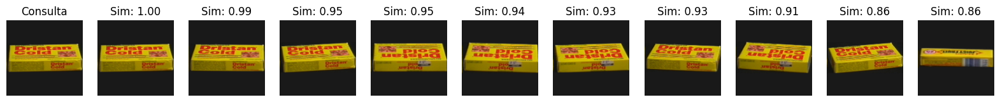

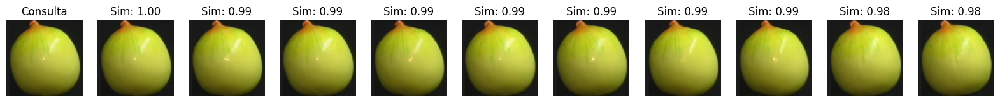

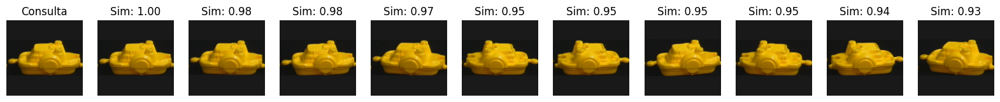

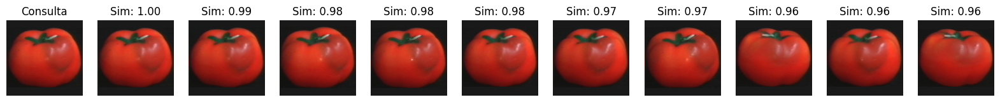

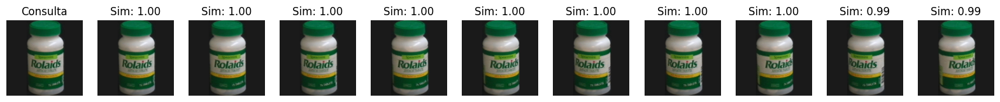

...

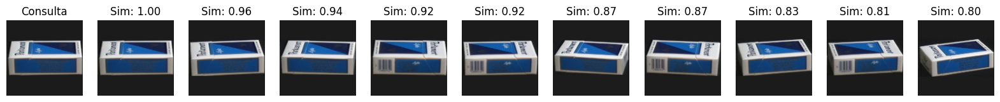

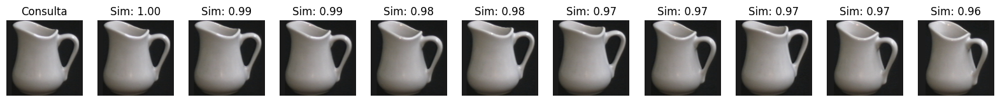

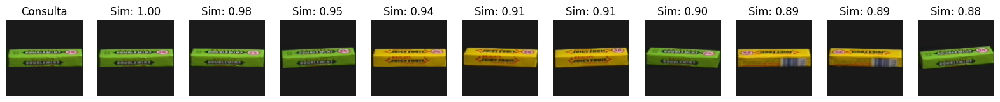

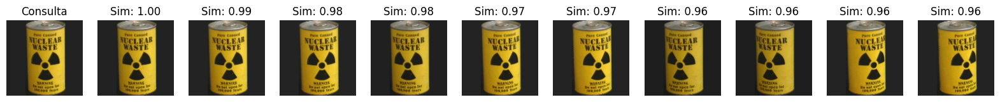

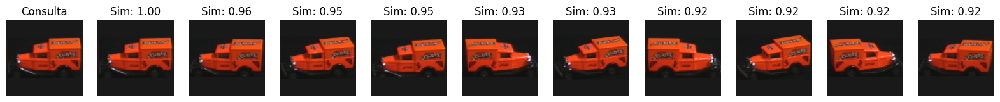

In [39]:
for obj in objs:
    consulta(obj=obj, total_consultas=10, figsize=(20,5))